# Experiment 1

In [1]:
#@title
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
%matplotlib inline
!pip install deeptrack

In [3]:
import deeptrack as dt
import numpy as np
import matplotlib.pyplot as plt

/usr/local/lib/python3.7/dist-packages/deeptrack/backend/_config.py:12: UserWarning: cupy not installed. GPU-accelerated simulations will not be possible
  "cupy not installed. GPU-accelerated simulations will not be possible"
/usr/local/lib/python3.7/dist-packages/deeptrack/backend/_config.py:25: UserWarning: cupy not installed, CPU acceleration not enabled
  warnings.warn("cupy not installed, CPU acceleration not enabled")


In [4]:
n = 3
path = f'/content/drive/MyDrive/Investigacion/Data/jpg/train/images/{n}.jpg'

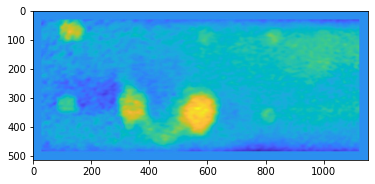

In [5]:
image = dt.LoadImage(path)()._value / 256
plt.imshow(image)

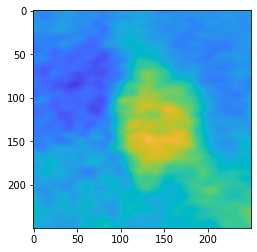

In [6]:
template = image[200:450,200:450]
plt.imshow(template)

In [7]:
train_set = (
    dt.Value(template)
    >> dt.Add(lambda: np.random.randn() * 0.1)
    >> dt.Gaussian(sigma=lambda:np.random.uniform(0, 0.2))  
    >> dt.Multiply(lambda: np.random.uniform(0.6, 1.2))
)

In [8]:
from deeptrack.models.lodestar.generators import LodeSTARGenerator

In [9]:
generator = LodeSTARGenerator(train_set)

In [10]:
generator.data

[]

In [ ]:
generator._continuous_get_training_data()

In [ ]:
generator.data

In [13]:
print("Properties")
print(f"Type: {type(generator.data)}")
print(f"Size: {len(generator.data[0])}")

Properties
Type: <class 'list'>
Size: 2


In [14]:
print(f" Type: {type(generator.data[0]['data'])}")
print(f" Size: {len(generator.data[0]['data'][0])}")

 Type: <class 'tuple'>
 Size: 32


In [ ]:
generator.data[0]["data"][0]

In [ ]:
generator.data[0]["data"][0][0]

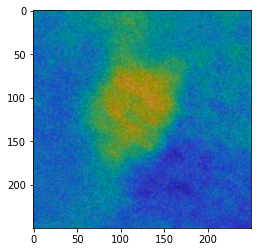

In [17]:
plt.imshow(generator.data[0]["data"][0][0])

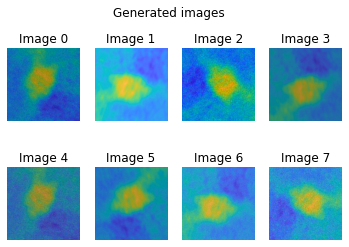

In [19]:
r = 2
c = 4
idx = 0
step = 1

fig, axs = plt.subplots(r, c)
fig.suptitle('Generated images')
for x in range(r):
    for y in range(c):
        #axs[x,y].imshow(generator.data[idx]["data"][0][0])
        #axs[x,y].imshow(generator.data[0]["data"][0][idx])
        axs[x,y].imshow(generator.data[idx]["data"][0][idx])
        
        axs[x,y].set_title(f'Image {idx}')
        axs[x,y].axis("off")
        idx += step

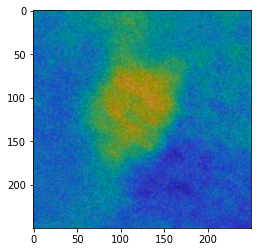

In [20]:
generator.data[0]["data"][1][3]
plt.imshow(generator.data[0]["data"][0][0])

In [21]:
len(generator.data[0]["data"][0][0])

250

# Experiment 2

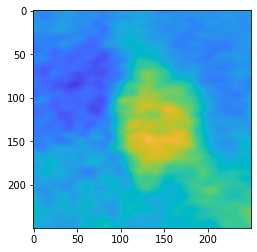

In [22]:
template = image[200:450,200:450]
plt.imshow(template)

In [23]:
from deeptrack.augmentations import Affine

In [37]:
"""
a = Affine(translate = lambda: np.random.randn(2) * 2)
b = Affine(rotate = lambda: np.random.rand() * 2 * np.pi * 2,)
c = Affine(scale = lambda: np.random.uniform(0.8,1.8, size=(2,)))
"""

# Transformations
a = Affine(translate = lambda: [np.random.randn() * 2] * 2)
b = Affine(rotate = lambda: np.random.rand() * 2 * np.pi * 2)
c = Affine(scale = lambda: [np.random.uniform(low=0.7, high=2)] * 2)

# There is no equivariance for shearing into DeepTrack library
#d = Affine(shear = lambda: np.random.rand() * np.pi/4)

In [38]:
from deeptrack.models.lodestar.equivariances import (
    ScaleEquivariance,
    TranslationalEquivariance,
    Rotational2DEquivariance,
)

In [39]:
# Define default transformations

#DEFAULT_TRANSFORMATION_FUNCTION = b >> a >> c
DEFAULT_TRANSFORMATION_FUNCTION2 = c >> b >> a

#DEFAULT_EQUIVARIANCE = ScaleEquivariance(c.scale)
DEFAULT_EQUIVARIANCE2 = ScaleEquivariance(c.scale) >> Rotational2DEquivariance(b.rotate) >> TranslationalEquivariance(a.translate)

In [40]:
generator2 = LodeSTARGenerator(train_set,
                               num_outputs=2,
                               transformation_function=(DEFAULT_TRANSFORMATION_FUNCTION2, DEFAULT_EQUIVARIANCE2)
                              )

In [ ]:
generator2._continuous_get_training_data()

In [42]:
print("Properties")
print(f"Type: {type(generator2.data)}")
print(f"Size: {len(generator2.data)}")

Properties
Type: <class 'list'>
Size: 26


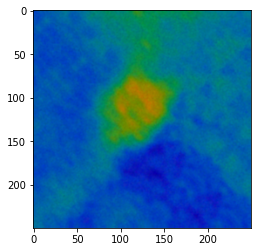

In [43]:
plt.imshow(generator2.data[0]["data"][0][0])

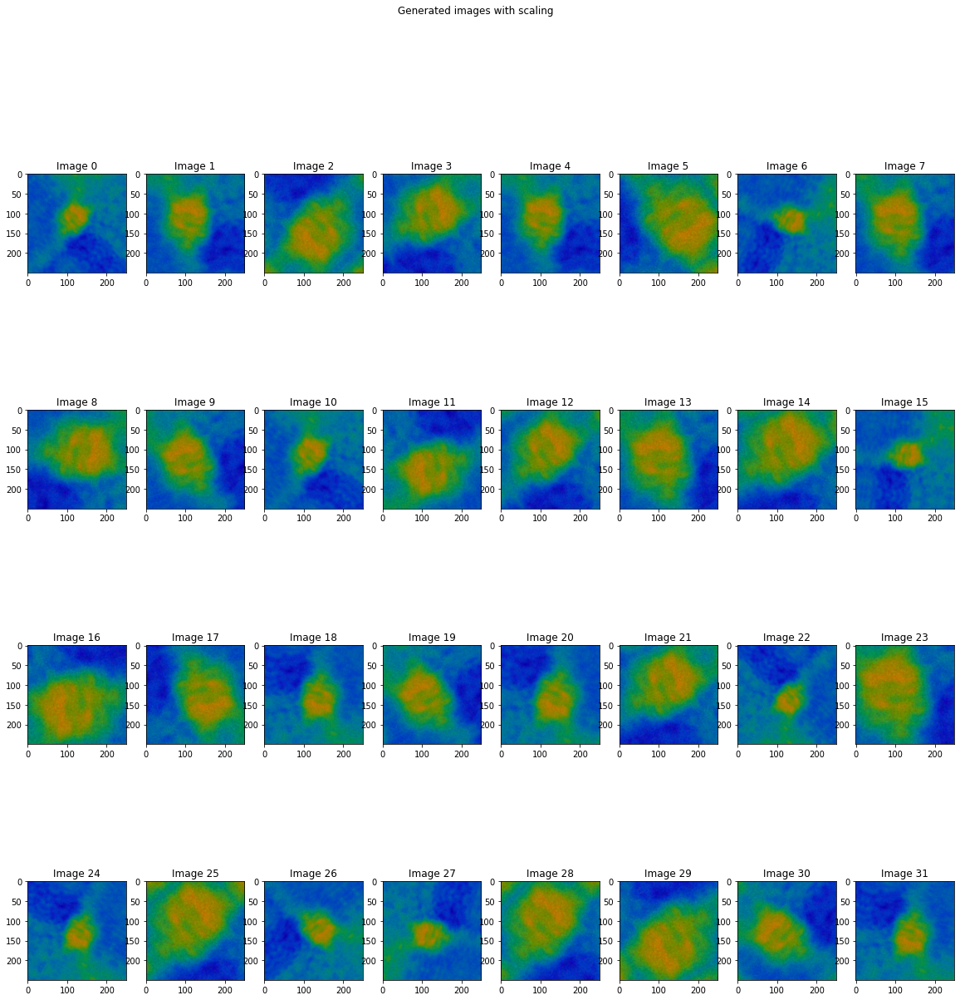

In [45]:
r = 4
c = 8
idx = 0
step = 1

fig, axs = plt.subplots(r, c, figsize = (20,20))
fig.suptitle('Generated images with scaling')
for x in range(r):
    for y in range(c):
        #axs[x,y].imshow(generator.data[idx]["data"][0][0])
        axs[x,y].imshow(generator2.data[0]["data"][0][idx])
        #axs[x,y].imshow(generator.data[idx]["data"][0][idx])
        
        axs[x,y].set_title(f'Image {idx}')
        #axs[x,y].axis("off")
        idx += step

-----

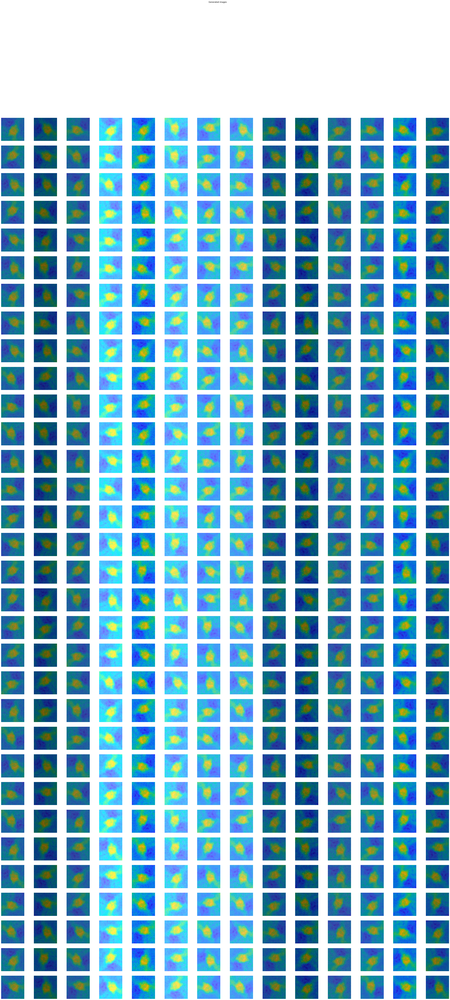

In [ ]:
fig, axs = plt.subplots(len(generator2.data[0]["data"][0]), len(generator2.data),figsize=(50,100))

fig.suptitle('Generated images')

for idx in range(0,len(generator2.data)):
    
    for idy in range(0,len(generator2.data[0]["data"][0])):

        #print('x es:',0,' y es:',idx)

        axs[idy,idx].imshow(generator2.data[idx]["data"][0][idy])

        

        #axs[idy,idx].set_title(f'Image {idx}')

        axs[idy,idx].axis("off")